# Enunciado

## Problema 3

### Descripcion

En este problema, se proporciona un conjunto de datos que contiene imágenes de escenas naturales de todo el mundo. El objetivo es construir un modelo de clasificación utilizando redes neuronales convolucionales (CNN) para clasificar estas imágenes en una de las seis categorías predefinidas.

### Dataset

El dataset proporcionado contiene alrededor de 25,000 imágenes de tamaño 150x150, distribuidas en seis categorías:
- buildings
- forest
- glacier
- mountain
- sea
- street

Las imágenes están divididas en tres conjuntos:
- Train: Alrededor de 14,000 imágenes para entrenamiento.
- Test: Alrededor de 3,000 imágenes para evaluación del modelo.
- Prediction: Alrededor de 7,000 imágenes para predicción final.


### Objetivo

Utilizando el dataset proporcionado, el objetivo es construir y comparar el rendimiento de distintos modelos de clasificación de imágenes utilizando redes neuronales convolucionales y densas que puedan clasificar con precisión las imágenes de escenas naturales en una de las seis categorías mencionadas anteriormente.

Los modelos a diseñar son:
- Modelo con capas densas.
- Modelo con capas convolucionales y densas.
- Modelo que incluya bloques residuales identidad.
- Modelo que utilice como backbone alguna de las arquitecturas disponibles en TensorFlow (transfer learning): https://www.tensorflow.org/api_docs/python/tf/keras/applications

Se debe entrenar y evaluar cada modelo utilizando técnicas adecuadas de validación y métricas de evaluación de clasificación.



In [ ]:
import numpy as np
from pathlib import Path
import tensorflow as tf
import matplotlib.pyplot as plt
import sys
import os
sys.path.append(str(os.path.abspath("")))

# Resolución

## Entorno

In [ ]:
import os
import subprocess
import zipfile

from plots import plot_fit, plot_predictions
import convXdense as cxd
import dense
import resnet3
import transfer

In [ ]:
DS_DESTINATION="media/TP1-3-natural-scenes.zip"
DS_UNZIP_DEST=DS_DESTINATION.replace(".zip","")
DS_DRIVE_ID="1Pqs5Y6dZr4R66Dby5hIUIjPZtBI28rmJ"
TRAIN_DIRECTORY = Path("media/TP1-3-natural-scenes/seg_train/seg_train/")
TEST_DIRECTORY = Path("media/TP1-3-natural-scenes/seg_test/seg_test/")
PRED_IMAGES_DIRECTORY = Path("media/TP1-3-natural-scenes/seg_pred/seg_pred/")
BATCH_SIZE = 150
IMAGE_HEIGHT = 150
IMAGE_WIDTH = 150


## Datasets

In [ ]:

if not os.path.isfile(DS_DESTINATION):
    print(subprocess.run(["gdown", DS_DRIVE_ID, "-O", DS_DESTINATION],
                        capture_output=True))
    with zipfile.ZipFile(DS_DESTINATION, 'r') as zip_ref:
        zip_ref.extractall(DS_UNZIP_DEST)

    for DIR in [TRAIN_DIRECTORY,TEST_DIRECTORY ] :
        path, directories, files = [ (p, d, f) for p,d,f in os.walk(DIR)][0]
        root_path = str(path)
        labels = directories

        for label in labels:
            current_dir = os.path.join(root_path, label)
            print(f"Working on dir {label} on {path}")
            for path, directories, image_files in os.walk(str(current_dir)):
                for image_file in image_files:
                    current_name = os.path.join(current_dir, image_file)
                    new_name = os.path.join(current_dir, label + "_" + image_file)
                    os.rename(current_name, new_name)

In [ ]:

# Carga los datos de entrenamiento y validación
train_ds = tf.keras.utils.image_dataset_from_directory(
    TRAIN_DIRECTORY,
    validation_split=0.2,
    subset="training",
    label_mode="categorical",
    seed=123,
    image_size=(IMAGE_HEIGHT, IMAGE_WIDTH),
    batch_size=BATCH_SIZE
    )

val_ds = tf.keras.utils.image_dataset_from_directory(
    TEST_DIRECTORY,
    validation_split=0.2,
    subset="validation",
    label_mode="categorical",
    seed=123,
    image_size=(IMAGE_HEIGHT, IMAGE_WIDTH),
    batch_size=BATCH_SIZE
    )

# Obtiene los nombres de las clases
class_names = train_ds.class_names
num_classes = len(class_names)
class_lens = {}
val_lens = {}


for c in class_names:
    train_dir = TRAIN_DIRECTORY.joinpath(c)
    val_dir = TEST_DIRECTORY.joinpath(c)
    class_lens[c] = len([name for name in os.listdir(train_dir)])
    val_lens[c] = len([name for name in os.listdir(val_dir)])

print(f"Train: {class_lens}")
print(f"Test:{val_lens}")

Found 14034 files belonging to 6 classes.
Using 11228 files for training.
Found 3000 files belonging to 6 classes.
Using 600 files for validation.
Train: {'buildings': 2191, 'forest': 2271, 'glacier': 2404, 'mountain': 2512, 'sea': 2274, 'street': 2382}
Test:{'buildings': 437, 'forest': 474, 'glacier': 553, 'mountain': 525, 'sea': 510, 'street': 501}


<Figure size 1000x1000 with 0 Axes>

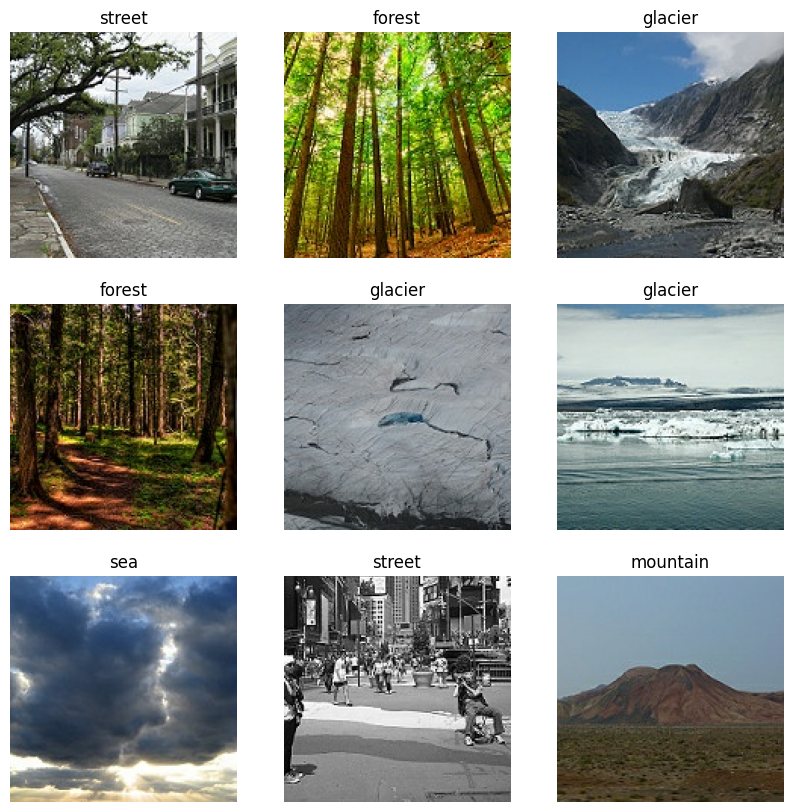

In [ ]:
plt.figure(figsize=(10, 10))

for images, labels in val_ds.take(1):
  plt.figure(figsize=(10, 10))
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    class_idx = list(labels[i]).index(1)

    plt.title(class_names[class_idx])
    plt.axis("off")

## Modelo con capas convolucionales y densas

In [ ]:
print("Building model Convulotion and Dense layers")
cxd_model = cxd.build_model((IMAGE_HEIGHT, IMAGE_WIDTH, 3), num_classes)

cxd_model.compile(
    optimizer='adam',
    loss="categorical_crossentropy",
    metrics=['accuracy'])

Building model Convulotion and Dense layers


In [ ]:
EPOCHS = 30
# Entrena el modelo
history = cxd_model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE
)

Epoch 1/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 22s 281ms/step - accuracy: 0.3580 - loss: 1.5121 - val_accuracy: 0.5450 - val_loss: 1.1203
Epoch 2/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 21s 279ms/step - accuracy: 0.5716 - loss: 1.0886 - val_accuracy: 0.6550 - val_loss: 0.8806
Epoch 3/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 21s 276ms/step - accuracy: 0.6422 - loss: 0.9328 - val_accuracy: 0.6967 - val_loss: 0.7887
Epoch 4/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 21s 283ms/step - accuracy: 0.6792 - loss: 0.8478 - val_accuracy: 0.6600 - val_loss: 0.9591
Epoch 5/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 20s 271ms/step - accuracy: 0.6933 - loss: 0.8348 - val_accuracy: 0.7183 - val_loss: 0.7333
Epoch 6/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 21s 286ms/step - accuracy: 0.6920 - loss: 0.8183 - val_accuracy: 0.7650 - val_loss: 0.6488
Epoch 7/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 21s 282ms/step - accuracy: 0.7259 - loss: 0.7498 - val_accuracy: 0.7583 - val_loss: 0.6801
Epoch 8/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 22s 291ms/step - accuracy: 0.7313 - loss: 0.7371 - val_accu

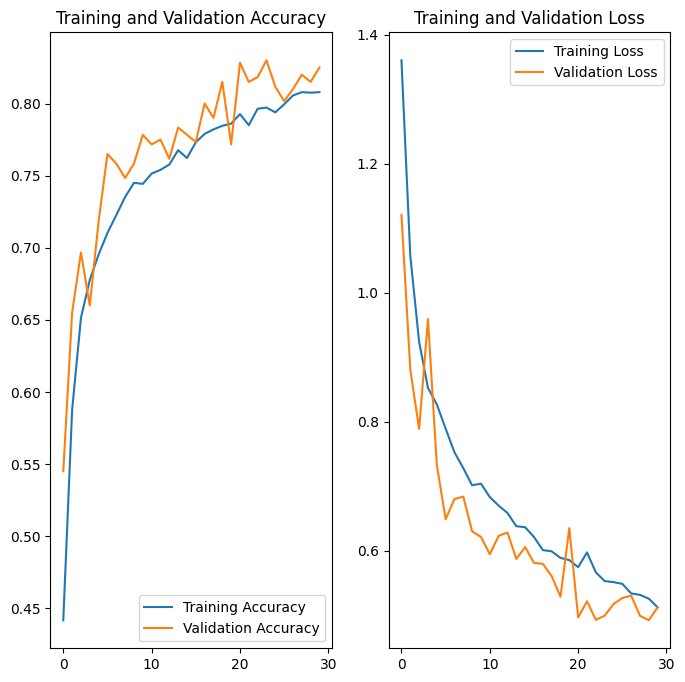

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
[[0.15638772 0.31534773 0.00089705 0.00158766 0.01288311 0.5128967 ]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
[[0.04136222 0.00091851 0.06614041 0.6635905  0.22668917 0.00129923]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[[4.0397456e-01 1.8858927e-05 3.9736943e-08 1.9546098e-09 1.2297817e-05
  5.9599429e-01]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[[0.00221525 0.00543099 0.5903655  0.39542866 0.00225692 0.00430259]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[[0.04194801 0.01348803 0.12085802 0.5940185  0.21815896 0.01152838]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[[3.2536150e-04 9.7247112e-01 3.8240829e-05 4.7020623e-03 2.2413641e-02
  4.9644899e-05]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
[[1.1232576e-03 1.2367828e-05 1.5200168e-02 1.3407591e-02 9.6998805e-01
  2.6866462e-04]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
[[3.6813252e-04 1.0920999e-05 9.9454331e-01 3.7350117e-03 2.6488036e-04
  1.0778067e-03]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
[[1.4107291e-01 8.

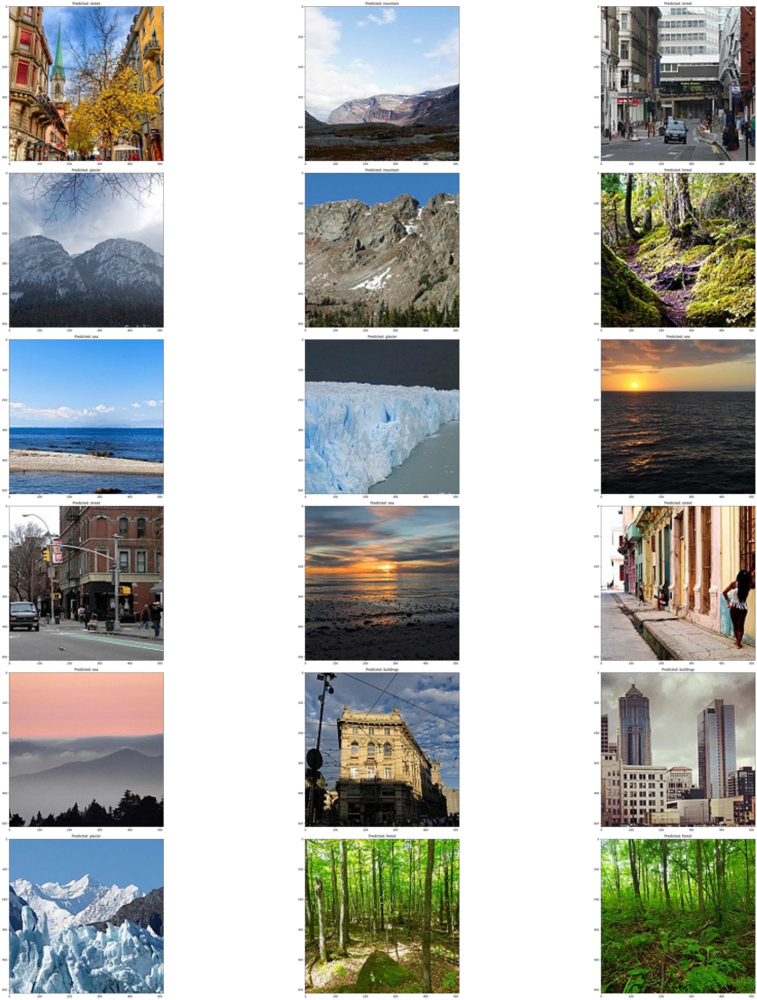

In [ ]:
plot_fit(history, epochs=EPOCHS)
plot_predictions(cxd_model, PRED_IMAGES_DIRECTORY, class_names)

El modelo de clasificación que utiliza tanto capas convolucionales como densas logra un rendimiento considerablemente sólido, con una precisión cercana al 80% en tanto el conjunto de entrenamiento como el de prueba después de 30 épocas de entrenamiento.

La arquitectura empleada parece ser efectiva en la extracción y abstracción de características relevantes de las imágenes, lo que resulta en una clasificación precisa de las escenas naturales en seis categorías predefinidas.

Sin embargo, se observa cierto ruido durante el entrenamiento hasta que el modelo converge, lo que sugiere posibles áreas de mejora en la estabilidad del entrenamiento.

## Modelo de capas densas

In [ ]:
print("Building model Convulotion and Dense layers")
dense_model = dense.build_model((IMAGE_HEIGHT, IMAGE_WIDTH, 3), num_classes)

dense_model.compile(
    optimizer='adam',
    loss="categorical_crossentropy",
    metrics=['accuracy'])
dense_model.summary()

Building model Convulotion and Dense layers


Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)      │ (None, 150, 150, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ rescaling_2 (Rescaling)         │ (None, 150, 150, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ random_flip_4 (RandomFlip)      │ (None, 150, 150, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ random_flip_5 (RandomFlip)      │ (None, 150, 150, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ random_translation_2            │ (None, 150, 150, 3)    │             0 │
│ (RandomTranslation)             │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ random_contrast_2               │ (None, 150, 150, 3)    │             0 │
│ (RandomContrast)                │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 67500)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 512)            │    34,560,512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_9 (Activation)       │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_10 (Activation)      │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_11 (Activation)      │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 6)              │           774 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_12 (Activation)      │ (None, 6)              │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 34,725,510 (132.47 MB)

 Trainable params: 34,725,510 (132.47 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
history = dense_model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE
)

Epoch 1/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 18s 233ms/step - accuracy: 0.2056 - loss: 17.7233 - val_accuracy: 0.3417 - val_loss: 2.1176
Epoch 2/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 18s 234ms/step - accuracy: 0.3776 - loss: 1.7461 - val_accuracy: 0.3167 - val_loss: 2.0493
Epoch 3/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 18s 240ms/step - accuracy: 0.4133 - loss: 1.6646 - val_accuracy: 0.4183 - val_loss: 1.5272
Epoch 4/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 18s 236ms/step - accuracy: 0.4361 - loss: 1.5059 - val_accuracy: 0.4600 - val_loss: 1.3650
Epoch 5/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 18s 239ms/step - accuracy: 0.4708 - loss: 1.3874 - val_accuracy: 0.4900 - val_loss: 1.3466
Epoch 6/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 18s 238ms/step - accuracy: 0.4794 - loss: 1.3628 - val_accuracy: 0.5417 - val_loss: 1.2501
Epoch 7/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 18s 236ms/step - accuracy: 0.4979 - loss: 1.3222 - val_accuracy: 0.4967 - val_loss: 1.3158
Epoch 8/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 20s 264ms/step - accuracy: 0.4826 - loss: 1.3449 - val_acc

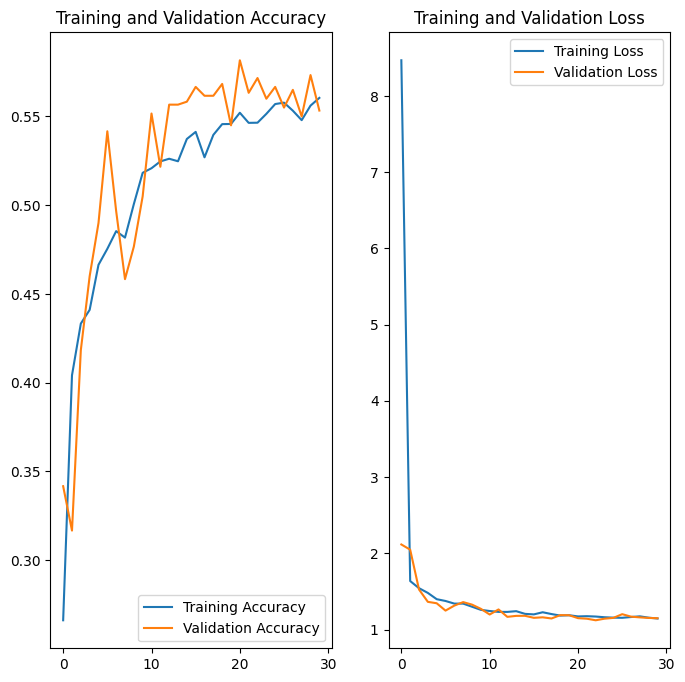

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
[[0.05120111 0.05653308 0.03416161 0.00610957 0.01610116 0.8358934 ]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[[1.01698255e-02 3.62720282e-04 3.84059548e-01 3.49169672e-01
  2.55696505e-01 5.41683869e-04]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[[0.13408814 0.06600843 0.01597209 0.01697386 0.03025925 0.73669827]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[[0.0236285  0.00078957 0.430373   0.394521   0.14834727 0.00234062]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[[0.14360414 0.03230621 0.10792498 0.14362854 0.5287519  0.04378424]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[[0.0917583  0.46520746 0.02981484 0.01536876 0.2572268  0.1406238 ]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
[[1.7181063e-02 5.0346647e-05 5.6451052e-01 1.8584037e-01 2.3212641e-01
  2.9124995e-04]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[[0.04885966 0.00376445 0.37893143 0.23283021 0.32945728 0.00615698]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
[[0.07201558 0.0327323  0.01482522 0.19004856 0.4763

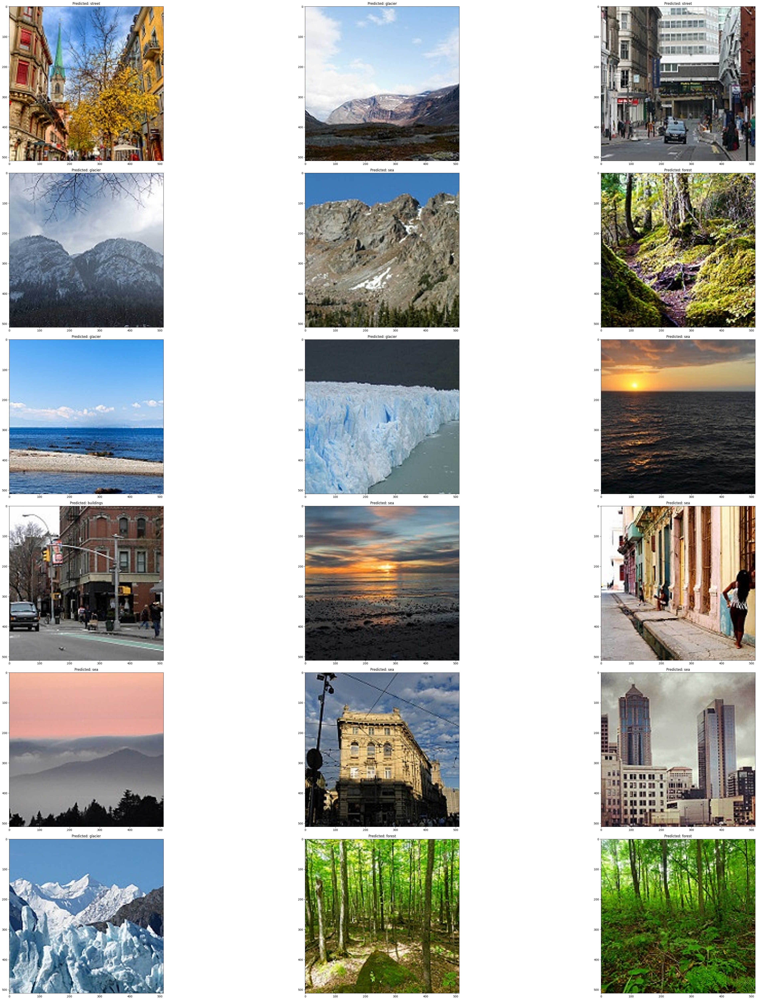

In [ ]:
plot_fit(history, epochs=EPOCHS)
plot_predictions(dense_model, PRED_IMAGES_DIRECTORY, class_names)

El modelo basado únicamente en capas densas muestra un rendimiento significativamente inferior en comparación con el modelo que combina capas convolucionales y densas.

Los gráficos de entrenamiento y validación del accuracy y loss son notablemente más ruidosos, indicando una mayor variabilidad en el rendimiento del modelo durante el entrenamiento.

Además, los valores de precisión son sustancialmente más bajos, aproximadamente alrededor del 55% tanto en el conjunto de entrenamiento como en el de prueba, mientras que la pérdida alcanza valores más altos, convergiendo hacia alrededor de 1.15.

Esto significa que la arquitectura de este modelo es inferior para realizar una terea de clasificación de imagenes como estas, y las capas convoluciones aportan gran valor para mejorar esta arquitectura.

## Modelo de bloques residuales

In [ ]:
print("Building model ResNet")
resnet_model = resnet3.build_model(
    (IMAGE_HEIGHT, IMAGE_WIDTH, 3),
    num_classes,
    filters_and_kernels = [
        (8,  (3,3)),
        (16, (3,3)),
        (32, (3,3)),
        (64, (3,3))
    ],
    match_filter_size=True
)

resnet_model.compile(
    optimizer='adam',
    loss="categorical_crossentropy",
    metrics=['accuracy'])
resnet_model.summary()

Building model ResNet
(None, 150, 150, 8) (None, 150, 150, 8)
(None, 75, 75, 16) (None, 75, 75, 16)
(None, 37, 37, 32) (None, 37, 37, 32)
(None, 18, 18, 64) (None, 18, 18, 64)


Model: "functional_15"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_20      │ (None, 150, 150,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_20        │ (None, 150, 150,  │          0 │ input_layer_20[0… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ random_flip_40      │ (None, 150, 150,  │          0 │ rescaling_20[0][… │
│ (RandomFlip)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ random_flip_41      │ (None, 150, 150,  │          0 │ random_flip_40[0… │
│ (RandomFlip)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ random_translation… │ (None, 150, 150,  │          0 │ random_flip_41[0… │
│ (RandomTranslation) │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ random_contrast_20  │ (None, 150, 150,  │          0 │ random_translati… │
│ (RandomContrast)    │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_54 (Conv2D)  │ (None, 150, 150,  │        224 │ random_contrast_… │
│                     │ 8)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_57       │ (None, 150, 150,  │          0 │ conv2d_54[0][0]   │
│ (Activation)        │ 8)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 150, 150,  │         32 │ activation_57[0]… │
│ (BatchNormalizatio… │ 8)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_55 (Conv2D)  │ (None, 150, 150,  │        584 │ batch_normalizat… │
│                     │ 8)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_58       │ (None, 150, 150,  │          0 │ conv2d_55[0][0]   │
│ (Activation)        │ 8)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 150, 150,  │         32 │ activation_58[0]… │
│ (BatchNormalizatio… │ 8)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 150, 150,  │         32 │ batch_normalizat… │
│ (BatchNormalizatio… │ 8)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_23 (Add)        │ (None, 150, 150,  │          0 │ batch_normalizat… │
│                     │ 8)                │            │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_13    │ (None, 75, 75, 8) │          0 │ add_23[0][0]      │
│ (MaxPooling2D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_59       │ (None, 75, 75, 8) │          0 │ max_pooling2d_13… │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_57 (Conv2D)  │ (None, 75, 75,    │      1,168 │ activation_59[0]

 Total params: 106,158 (414.68 KB)

 Trainable params: 105,438 (411.87 KB)

 Non-trainable params: 720 (2.81 KB)

In [ ]:
history = resnet_model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE
)

plot_fit(history, epochs=EPOCHS)
plot_predictions(dense_model, PRED_IMAGES_DIRECTORY, class_names)

Epoch 1/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 80s 1s/step - accuracy: 0.3669 - loss: 3.6071 - val_accuracy: 0.1633 - val_loss: 3.0525
Epoch 2/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 75s 993ms/step - accuracy: 0.5513 - loss: 1.2584 - val_accuracy: 0.1817 - val_loss: 4.9365
Epoch 3/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 76s 1s/step - accuracy: 0.6301 - loss: 1.0036 - val_accuracy: 0.2333 - val_loss: 5.1431
Epoch 4/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 74s 990ms/step - accuracy: 0.6769 - loss: 0.9180 - val_accuracy: 0.1850 - val_loss: 5.3765
Epoch 5/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 73s 978ms/step - accuracy: 0.6841 - loss: 0.9871 - val_accuracy: 0.2800 - val_loss: 3.3101
Epoch 6/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 74s 984ms/step - accuracy: 0.7167 - loss: 0.9037 - val_accuracy: 0.5100 - val_loss: 1.5941
Epoch 7/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 76s 1s/step - accuracy: 0.7282 - loss: 0.8653 - val_accuracy: 0.7350 - val_loss: 0.7480
Epoch 8/30
75/75 ━━━━━━━━━━━━━━━━━━━━ 79s 1s/step - accuracy: 0.7409 - loss: 0.7600 - val_accuracy: 0.7617

El modelo de bloques residuales identidad muestra un rendimiento inicial prometedor, alcanzando una precisión máxima en el conjunto de validación del 76%. Sin embargo, se observa un claro caso de sobreajuste a partir de la décima época de entrenamiento, donde la precisión en el conjunto de validación disminuye mientras la del conjunto de entrenamiento continúa mejorando. Esto sugiere que el modelo puede estar demasiado complejo para el conjunto de datos o que se requieren ajustes adicionales en la configuración, como la incorporación de regularización o una arquitectura de bloques residuales más profunda y cuidadosamente ajustada.

Dado que los bloques residuales pueden ser bastante sensibles a la configuración, una revisión detallada de la arquitectura y los hiperparámetros podría mejorar significativamente el rendimiento del modelo. Con la configuración actual, el modelo tiene un rendimiento aceptable, pero no superior al primero conformado por la combinación de capas densas y convolucionales.

## Modelo con backbone

In [ ]:

print("Building model Transfer Learning")
transfer_model = transfer.build_model(
    (IMAGE_HEIGHT, IMAGE_WIDTH, 3),
    num_classes
)

# compile and train in 10 epochs the pre-trained model
transfer_model.compile(
    optimizer='adam',
    loss="categorical_crossentropy",
    metrics=['accuracy'])
transfer_model.summary()

In [ ]:
history = transfer_model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE
)

plot_fit(history, epochs=EPOCHS)
plot_predictions(dense_model, PRED_IMAGES_DIRECTORY, class_names)

El modelo que usa otro modelo pre-entrenado, en este caso MobileNetV2, utilizando tecnicas de transfer learning, notamos un rendimiento levemente superior al modelo basado en capas densas y convolucionales.

Se consigue un entramiento muy estable y relativamente balanceado con una presición del 85%, por lo que se demuestra que de una arquitectura muy sencilla, ya que la complejidad y entramiento se hererda, se puede obtener un modelo de clasificacion de imagenes eficiente.

Ademas se consigue que el modelo converga mucho mas rapido, con tan solo 10 epocas ya se consiguen resultados aceptables para esta tarea.

## Conclusión

El modelo que hereda conocimiento de redes pre-entrenadas es superior a los demas modelos construidos manualmente, aunque el modelo construido con capas convolucionales y capas densas se acerca bastante en presicion, aunque con un entremiento mas ruidoso.